In [1]:
#install kaggle to upload kaggle's dataset
!pip install kaggle
!pip install pytorch_lightning

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 722.8/722.8 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.6/731.6 kB 16.9 MB/s eta 0:00:00


In [2]:
#looking for a datasaet
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!kaggle datasets list -s anime-face

ref                                                     title                                             size  lastUpdated          downloadCount  voteCount  usabilityRating  
------------------------------------------------------  -----------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
splcher/animefacedataset                                Anime Face Dataset                               395MB  2019-10-13 16:33:20          21372        316  0.9375           
soumikrakshit/anime-faces                               Anime Faces                                      441MB  2019-05-16 10:38:47           9578        187  0.625            
scribbless/another-anime-face-dataset                   another anime face dataset                         1GB  2021-04-24 12:42:57           2062         50  0.8125           
subinium/highresolution-anime-face-dataset-512x512      High-Resolution Anime Face Dataset (512x512)      15GB  202

In [3]:
#downloading the dataset
!kaggle datasets download -d splcher/animefacedataset

 99% 392M/395M [00:11<00:00, 33.2MB/s]
100% 395M/395M [00:11<00:00, 34.8MB/s]


In [4]:
#mooving dataset to a dir
!mkdir Dataset
!cp /content/animefacedataset.zip /content/Dataset/animefacedataset.zip
!unzip -q /content/Dataset/animefacedataset.zip -d /content/Dataset
!rm /content/Dataset/animefacedataset.zip

In [5]:
%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [6]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [32]:
# Root directory for dataset
dataroot = "/content/data"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 20

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

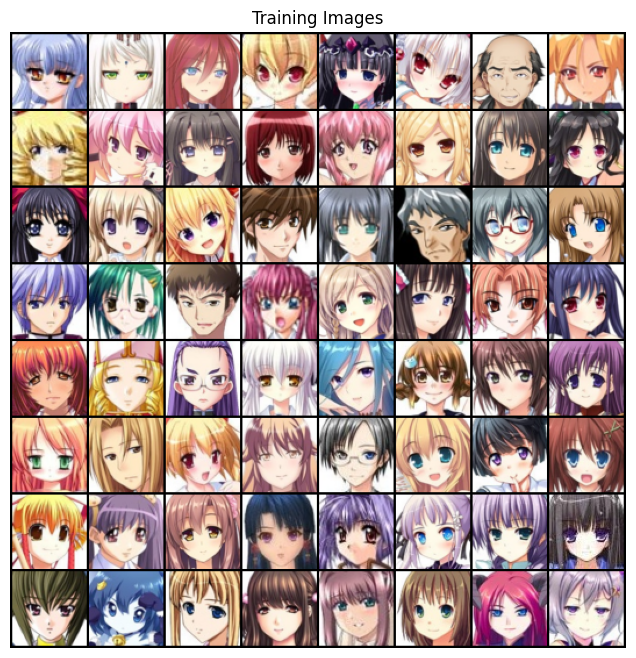

In [8]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [9]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [10]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [11]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [12]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [13]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [14]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [33]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/20][0/497]	Loss_D: 0.3256	Loss_G: 3.4978	D(x): 0.8215	D(G(z)): 0.0781 / 0.0458
[0/20][50/497]	Loss_D: 0.5654	Loss_G: 8.4650	D(x): 0.9912	D(G(z)): 0.3668 / 0.0005
[0/20][100/497]	Loss_D: 1.0428	Loss_G: 2.7794	D(x): 0.4908	D(G(z)): 0.0036 / 0.1142
[0/20][150/497]	Loss_D: 0.2364	Loss_G: 5.0086	D(x): 0.8834	D(G(z)): 0.0803 / 0.0130
[0/20][200/497]	Loss_D: 0.2586	Loss_G: 4.6485	D(x): 0.8686	D(G(z)): 0.0865 / 0.0160
[0/20][250/497]	Loss_D: 0.2123	Loss_G: 6.2468	D(x): 0.9272	D(G(z)): 0.1072 / 0.0050
[0/20][300/497]	Loss_D: 0.3077	Loss_G: 6.2573	D(x): 0.9636	D(G(z)): 0.2066 / 0.0036
[0/20][350/497]	Loss_D: 0.4884	Loss_G: 4.4620	D(x): 0.6827	D(G(z)): 0.0082 / 0.0231
[0/20][400/497]	Loss_D: 1.1529	Loss_G: 11.1697	D(x): 0.9878	D(G(z)): 0.5984 / 0.0001
[0/20][450/497]	Loss_D: 0.5471	Loss_G: 7.0975	D(x): 0.6523	D(G(z)): 0.0023 / 0.0020
[1/20][0/497]	Loss_D: 0.5607	Loss_G: 8.4129	D(x): 0.9915	D(G(z)): 0.3612 / 0.0006
[1/20][50/497]	Loss_D: 0.3743	Loss_G: 2.9529	D(x): 0.7

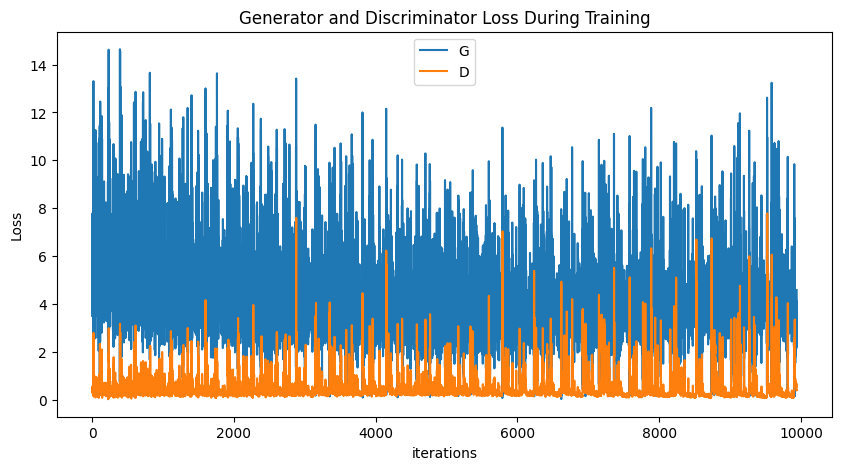

In [34]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

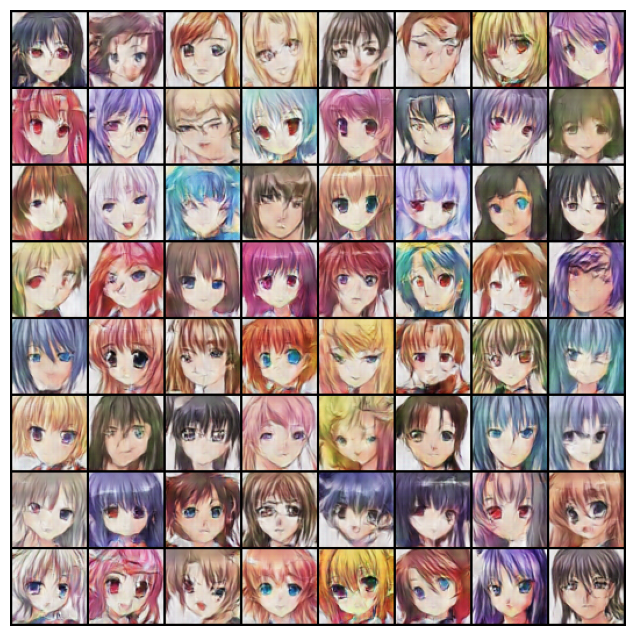

In [35]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

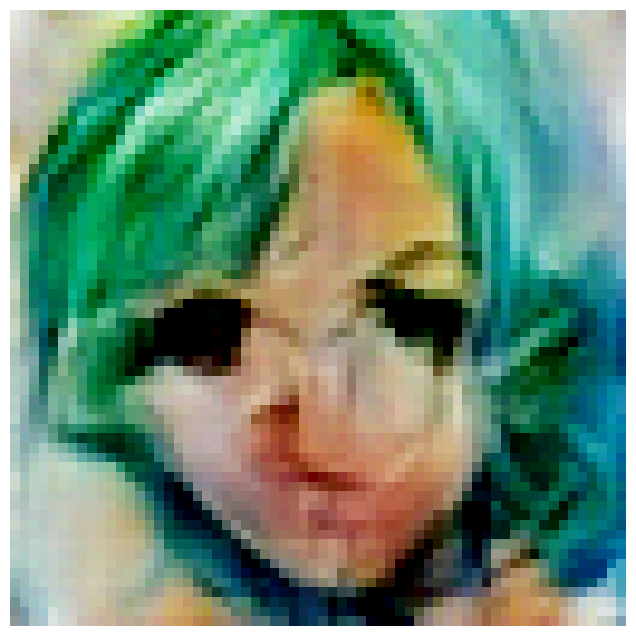

In [67]:
noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
fake = netG(noise)

with torch.no_grad():
  img = fake[0].cpu().numpy()
  fig = plt.figure(figsize=(8,8))
  plt.axis("off")
  plt.imshow(np.transpose(img,(1,2,0)), animated=True)
  plt.savefig(f'output_image_{i}.png')
  i+=1

In [68]:
torch.save(netG.state_dict(), "dcgan_mark_1.pth")

In [ ]:
model = torch.load('/content/dcgan_mark_1.pth')

In [69]:
#loading a vae model if needed
model_path = '/content/dcgan_mark_1.pth'
# Load the model and map it to the CPU.
loaded_state_dict = torch.load(model_path)

#making a vae instanse to apply weights
gan = Generator(ngpu).to(device)
#applying weights
gan.load_state_dict(loaded_state_dict)

<All keys matched successfully>

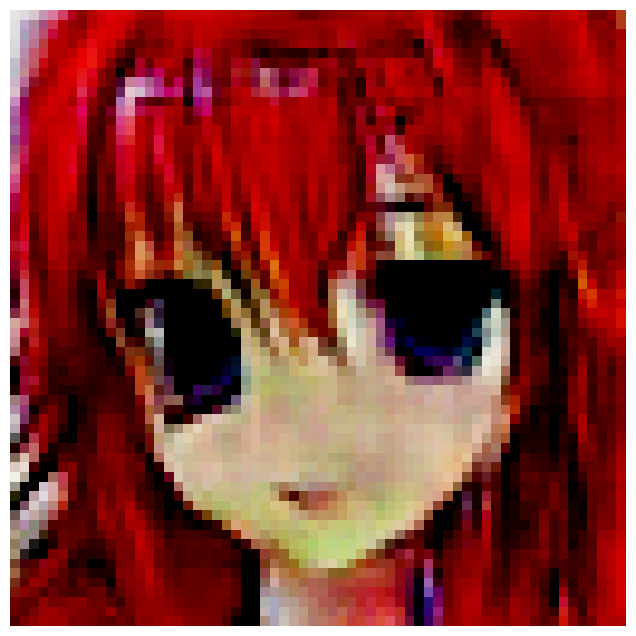

In [70]:
noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
fake = gan(noise)

with torch.no_grad():
  img = fake[0].cpu().numpy()
  fig = plt.figure(figsize=(8,8))
  plt.axis("off")
  plt.imshow(np.transpose(img,(1,2,0)), animated=True)
  plt.savefig(f'output_image_{i}.png')
  i+=1

In [9]:
#making a custom dataset to change img to a needed format
class IMG_dataset(torch.utils.data.Dataset):
    def __init__(self, path_dir:str):
        super().__init__()
        self.path_dir = path_dir
        self.dir_list = sorted([f for f in os.listdir(path_dir) if os.path.isfile(os.path.join(path_dir, f))]) #get filenames in a path dir
        self.dir_list = self.dir_list

        # self.dir_list = self.dir_list[:10000] #take only fist 10000 img


    def __len__(self):
        return len(self.dir_list)

    def __getitem__(self, idx):
        img_path = os.path.join(self.path_dir, self.dir_list[idx])
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)  # Load image as RGB
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
        img = img.astype(np.float32) / 255.0    #normalizing images
        img = cv2.resize(img, (64, 64), interpolation=cv2.INTER_LINEAR) #set size to img
        img = img.transpose((2, 0, 1))
        t_img = torch.from_numpy(img) #making a pytorch tensor from numpy array

        return t_img

In [10]:
train_face_path = "/content/Dataset/images" #path to the folder with img
train_face = IMG_dataset(train_face_path)

In [11]:
#making a dataloader
batch_size = 64

train_loader = torch.utils.data.DataLoader(
    train_face, shuffle=True,
    batch_size=batch_size, num_workers=1, drop_last=True
)


In [12]:
#check if the loader works and check img size
for img in train_loader:
  print(img.shape)
  break

torch.Size([64, 3, 64, 64])


In [29]:
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        # Convolutional layers
        self.conv_layers = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(256, 1, kernel_size=4, stride=2, padding=1)  # Modify the last convolutional layer
        )

    def forward(self, x):
        x = self.conv_layers(x)
        return x.view(-1, 1)  # Adjust the output shape if necessary


In [30]:
class Generator(nn.Module):
    def __init__(self, output_channels=3, hidden_dims=128):
        super(Generator, self).__init__()
        self.linear = nn.Linear(hidden_dims, 8 * 8 * 128)  # Adjusted linear layer
        self.deconv1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.bn1 = nn.BatchNorm2d(64)  # BatchNorm after the first deconv layer
        self.deconv2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.bn2 = nn.BatchNorm2d(32)  # BatchNorm after the second deconv layer
        self.deconv3 = nn.ConvTranspose2d(32, output_channels, kernel_size=4, stride=2, padding=1)
        self.act = nn.ReLU()

    def forward(self, z):
        x = self.act(self.linear(z))
        x = x.view(-1, 128, 8, 8)  # Reshape to match the shape after the linear layer
        x = self.act(self.bn1(self.deconv1(x)))  # Apply BatchNorm after the first deconv layer
        x = self.act(self.bn2(self.deconv2(x)))  # Apply BatchNorm after the second deconv layer
        x = torch.sigmoid(self.deconv3(x))  # Apply Tanh activation to ensure pixel values are in the range [0, 1]
        return x


In [31]:
class GAN(pl.LightningModule):
    def __init__(self, input_channels=3, hidden_dims=128, lr=0.0001):
        super(GAN, self).__init__()
        self.save_hyperparameters()
        self.generator = Generator(input_channels, hidden_dims)
        self.discriminator = Discriminator()
        self.automatic_optimization = False
        self.z = torch.randn(32, hidden_dims)

    def forward(self, z):
        return self.generator(z)

    def adversarial_loss(self, y_hat, y):
        return F.binary_cross_entropy_with_logits(y_hat, y)  # Using with_logits version

    def training_step(self, batch, batch_idx):
      imgs = batch

      opt_g, opt_d = self.optimizers()

      batch_size = imgs.size(0)  # Get the actual batch size

      z = torch.randn(batch_size, self.hparams.hidden_dims, device=self.device)

      # Train generator
      valid = torch.ones(batch_size, 1, device=self.device)
      fake = torch.zeros(batch_size, 1, device=self.device)

      self.toggle_optimizer(opt_g)
      g_loss = self.adversarial_loss(self.discriminator(self.generator(z)), valid)
      opt_g.zero_grad()
      self.manual_backward(g_loss)
      opt_g.step()
      self.untoggle_optimizer(opt_g)

      # Train discriminator
      self.toggle_optimizer(opt_d)
      real_loss = self.adversarial_loss(self.discriminator(imgs), valid)

      fake_loss = self.adversarial_loss(self.discriminator(self.generator(z).detach()), fake)

      d_loss = (real_loss + fake_loss) / 2

      opt_d.zero_grad()
      self.manual_backward(d_loss)
      opt_d.step()
      self.untoggle_optimizer(opt_d)

      self.log_dict({"d_loss": d_loss, "g_loss": g_loss})

      return {"d_loss": d_loss, "g_loss": g_loss}


    def configure_optimizers(self):
        lr = self.hparams.lr
        opt_g = torch.optim.Adam(self.generator.parameters(), lr=lr)
        opt_d = torch.optim.Adam(self.discriminator.parameters(), lr=lr)
        return [opt_g, opt_d]

    def plot_imgs(self):

        z = torch.randn(64, self.hparams.hidden_dims)
        z = z.type_as(self.generator.linear.weight)
        with torch.no_grad():
            z = self(z)


            image_np = z.cpu().numpy()
            image_np = (image_np * 255).astype(int)

            plt.figure(figsize=(2, 1))
            plt.imshow(image_np[1].transpose(1, 2, 0))
            plt.axis('off')  # Remove axis ticks and labels


            plt.show() #plot generated img

        # print(image_np)

        # for i in range(min(sample_imgs.size(0), 6)):
        #     plt.subplot(2, 3, i + 1)
        #     plt.tight_layout()
        #     plt.imshow(sample_imgs.detach()[i, 0, :, :])
        #     plt.title('Generated data')
        #     plt.xticks([])
        #     plt.yticks([])
        #     plt.axis('off')

        #     img_filename = f"generated_images_{self.current_epoch}/epoch_{self.current_epoch}_img_{i}.png"
        #     save_image(sample_imgs[i, :, :, :], img_filename)  # Save the image
        # plt.show()
        # plt.close()


    def on_train_epoch_end(self):
        # Save model after each epoch
        checkpoint_dir =  'checkpoints'
        os.makedirs(checkpoint_dir, exist_ok=True)
        checkpoint_path = os.path.join(checkpoint_dir, f'epoch{self.current_epoch}.ckpt')
        torch.save(self.state_dict(), checkpoint_path)

        print(f'gen - {self.current_epoch}')
        self.plot_imgs()




In [32]:
hidden_dims = 512
output_chanels = 3
data = train_loader
num_epochs = 4

In [33]:
#info
pytorch_total_params = sum(p.numel() for p in GAN().parameters() if p.requires_grad)
pytorch_total_params

1886180

In [34]:
gan = GAN(output_chanels, hidden_dims).to(device)

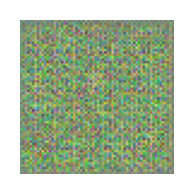

In [35]:
gan.plot_imgs()

In [36]:
trainer = pl.Trainer(max_epochs=30)
trainer.fit(gan, data)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name          | Type          | Params
------------------------------------------------
0 | generator     | Generator     | 4.4 M 
1 | discriminator | Discriminator | 663 K 
------------------------------------------------
5.0 M     Trainable params
0         Non-trainable params
5.0 M     Total params
20.128    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

ValueError: ignored

In [ ]:
gan_copy = gan

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name          | Type          | Params
------------------------------------------------
0 | generator     | Generator     | 1.2 M 
1 | discriminator | Discriminator | 676 K 
------------------------------------------------
1.9 M     Trainable params
0         Non-trainable params
1.9 M     Total params
7.594     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

gen - 0


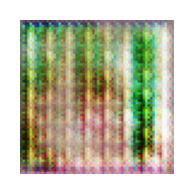

gen - 1


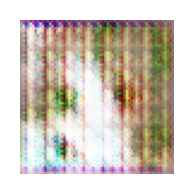

gen - 2


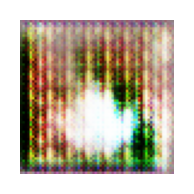

In [ ]:
trainer = pl.Trainer(max_epochs=30)
trainer.fit(model, data)

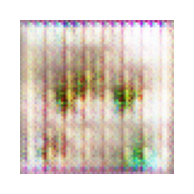

In [ ]:
gan.plot_imgs()

In [ ]:
gan_cont.hparams.lr = 0.002
gan_cont.hparams.lr

0.002

In [ ]:
# Save the model
torch.save(gan.state_dict(), "gan_mark_.pth")

In [ ]:
gan.plot_imgs()

In [ ]:
#load model gan
model_path = '/content/checkpoints/epoch29.ckpt'
# Load the model and map it to the CPU.
model = GAN()
checkpoint_path = '/content/checkpoints/epoch29.ckpt'
checkpoint = torch.load(checkpoint_path)

model.load_state_dict(checkpoint)



<All keys matched successfully>

In [ ]:
model.hparams.lr = 0.01

In [ ]:
#loading a vae model if needed
model_path = '/content/gan_mark_.pth'
# Load the model and map it to the CPU.
loaded_state_dict = torch.load(model_path)

#making a vae instanse to apply weights
gan = GAN()
#applying weights
gan.load_state_dict(loaded_state_dict)

In [ ]:
## GENERATING AN IMG

#generating a sample from normal distribution to generate a picture
batch_size = 4

z = gan.z.type_as(gan.generator.linear.weight)


#getting decoder's output for a z
with torch.no_grad():
    if torch.cuda.is_available():
        z = z.cuda()
        gan = gan.cuda()
    reconstructed_image = gan(z)


# Convert the tensor to a NumPy array
image_np = reconstructed_image.squeeze(0).cpu().numpy()

#the image is in range [0, 1], rescale it to [0, 255] for visualization
image_np = (image_np * 255).astype(int)
print(image_np.shape)
print(image_np)

i=0
for pic in range(4):
  # Plot the image using matplotlib
  plt.imshow(image_np[pic].transpose(1, 2, 0))
  plt.axis('off')  # Remove axis ticks and labels
  #output_path = f'generated_image_{i}_third_gen.jpg'

  #plt.savefig(output_path) # save generated img

  plt.show() #plot generated img
  i+=1

In [ ]:
import shutil

def delete_folder(folder_path):
    try:
        shutil.rmtree(folder_path)
        print(f"Folder '{folder_path}' and its contents have been deleted successfully.")
    except Exception as e:
        print(f"An error occurred: {e}")

# Example usage
folder_to_delete = "/content/lightning_logs"
delete_folder(folder_to_delete)


Folder '/content/lightning_logs' and its contents have been deleted successfully.
